In [1]:
#%reset
# import packages
import pandas as pd
pd.set_option("display.precision", 2)
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import seaborn as sns
import numpy as np
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import os
sns.set()
import re
warnings.filterwarnings('ignore')
from pylab import *
sns.set()
# pip3 install -U scikit-learn scipy matplotlib
def jitter(values,j):
    return values + np.random.normal(j,0.01,values.shape)


In [2]:
# read data preprocessed in knime
df = pd.read_csv('../data/daint-data/data_20220901_toxclass.csv', encoding ='utf8' , engine='python')
print(df.shape)
df['model'] = df['model'].str.replace(" ", "")
df['fps'] = df['fps'].str.replace("RDkit", "RDKit")
df['fps_class'] = df['fps_class'].str.replace("RDkit", "RDKit")
df = df.drop(df[df['model'] == "NaiveBayes"].index)
df.rename(columns = {'sample':'subsampling', 'resample':'resampling'}, inplace = True)
vals_to_replace = {'rf':'tree', 'CSimca' :'simca', 'kernelpls':'pls', 'kknn':'knn', 'RRF':'tree', 'RandomForest':'tree', 
          'DecisionTree':'tree', 'adaboost':'boost-tree', 'AdaBag':'boost-tree', 'bayesglm':'linear', 'GeneralizedLinearModel(H2O)':'linear',
          'glmStepAIC':'linear', 'LogisticRegression':'linear', 'regLogistic':'linear', 'deepboost':'boost-tree', 'GradientBoostedTrees':'boost-tree',
          'XGBoostTrees':'xboost-tree', 'xgbTree':'xboost-tree', 'DeepLearning(Keras)':'deep', 'NeuralNetwork':'deep', 'pcaNNet':'deep',
          'glmnet':'deep', 'nnet':'deep', 'avNNet':'deep', 'svmPoly':'svm', 'gaussprRadial':'svm','svmRadialCost':'svm','svmRadialCost':'gaussian', 'gbm':'boost-tree'}
df['model'] = df['model'].map(vals_to_replace)

(540771, 15)


In [ ]:
print(df['model'].unique())
print(df['subsampling'].unique())
print(df['resampling'].unique())
print(df['fps'].unique())
print(df['fps_class'].unique())
print(df['class'].unique())
print(df.columns)
print(df.size)
print(df.info)
print(df.shape)
print(df.head)
print(df.dtypes)
df_daint.describe()
print(df['model'].unique())

In [35]:
#missing data
total = df.isnull().sum().sort_values(ascending=False)
percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

,Total,Percent
sensitivity,0,0.0
specificity,0,0.0
precision,0,0.0
F,0,0.0
class,0,0.0
fps,0,0.0
model,0,0.0
subsampling,0,0.0
resampling,0,0.0
cyto,0,0.0


In [3]:
# step 0 general groups 
df_daint = df[df['source'] == "daint"]
df_knime_oob= df[df['source'] == "knime-oob"]
df_knime_fb= df[df['source'] == "knime-fb"]
frames = [df_daint, df_knime_oob]
df_con = pd.concat(frames)
df_con.model.unique()
df_cytotox = df[df['cyto'] == 'yes']
df_nocytotox = df[df['cyto'] == "no"]
df_xboost = df_con[df_con['model'] == "xboost-tree"]

In [4]:
df_class = pd.read_csv('../data/tox21-data/class_endpoint_mechtarget_reftable.csv', encoding ='utf8' , engine='python')
df_class.rename(columns = {'class_id':'class'}, inplace = True)
df_class['class'] = df_class['class'].str.replace("_", "")

In [5]:
df_con_class = pd.merge(df_con, df_class, on='class')
df_con_mechT = df_con_class.groupby(['mechT'], as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_con_target = df_con_class.groupby(['mechT','fps','model'], as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_con_target_max = df_con_class.groupby(['mechT','fps','model'], as_index=False).max(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])

df_con_target_cyto = df_con_class.groupby(['mechT','fps','model', 'ctb'], as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_con_target_cyto_max = df_con_class.groupby(['mechT','fps','model', 'ctb'], as_index=False).max(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_con_target_fpsclass = df_con_class.groupby(['mechT','fps_class','model'], as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
df_con_target_cyto_fpsclass = df_con_class.groupby(['mechT','fps_class','model', 'ctb'], as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])

In [39]:
df_con_class.head(3)

,sensitivity,specificity,precision,F,class,fps,model,subsampling,resampling,cyto,...,hitc_sum,hitc_count,aeid_unique#,aenm_concat,DTXSID_unique#,adapted_status,ctb,aenm_unique,assay,hitc_perc
0,1.0,0.0,0.02,0.05,class143,Atompair,simca,none,LGOCV,no,...,13,826,1,NVS_GPCR_rTRH,824,adapted,True,NVS_GPCR_rTRH,NVS_GPCR_rTRH,0.02
1,1.0,0.0,0.02,0.05,class143,Atompair,simca,none,LGOCV,no,...,20,833,1,NVS_GPCR_rTRH,830,adapted2,False,NVS_GPCR_rTRH,NVS_GPCR_rTRH,0.02
2,1.0,0.0,0.02,0.05,class143,Atompair,simca,none,boot,no,...,13,826,1,NVS_GPCR_rTRH,824,adapted,True,NVS_GPCR_rTRH,NVS_GPCR_rTRH,0.02


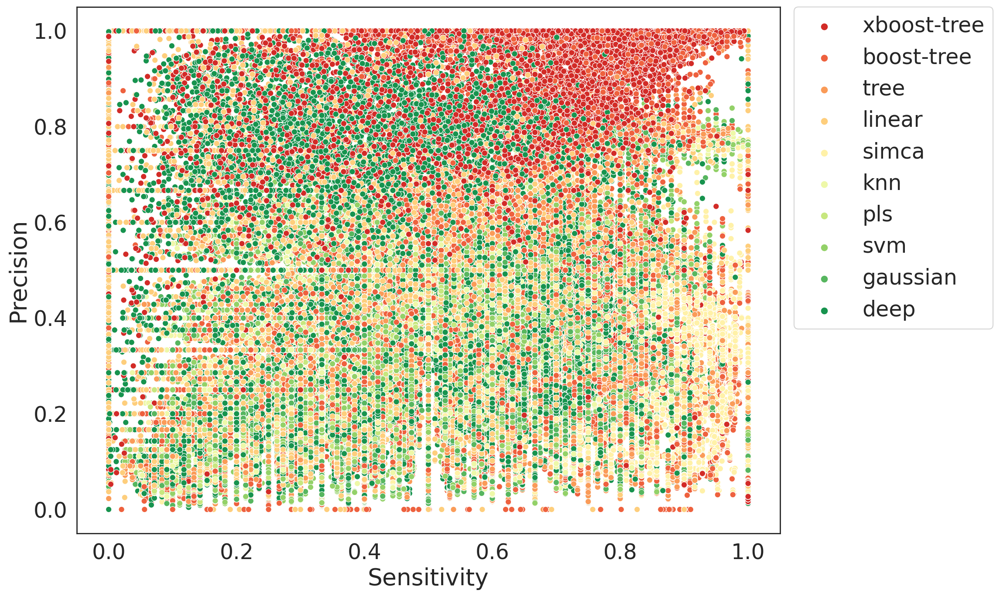

In [10]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']

ax = sns.scatterplot(data=df_con, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", 
               hue_order=hue_order, linewidth=0.5, alpha = 1)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_allpoints_sensitivity-vs-precision_hue-model.png', bbox_inches = 'tight')

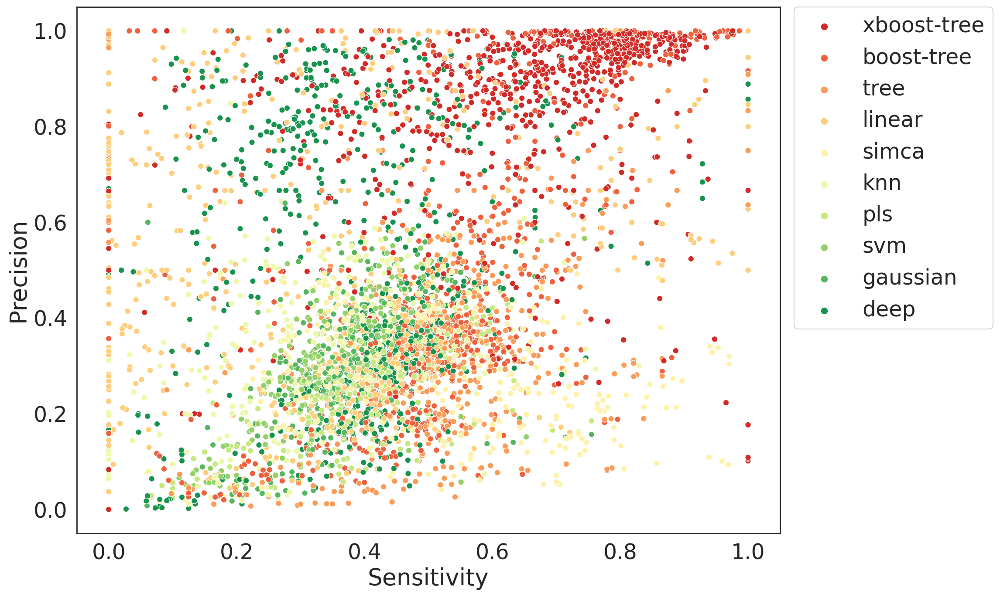

In [11]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']

ax = sns.scatterplot(data=df_con_target, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", 
               hue_order=hue_order, linewidth=0.5, alpha = 1)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_permechtarget_sensitivity-vs-precision_hue-model.png', bbox_inches = 'tight')

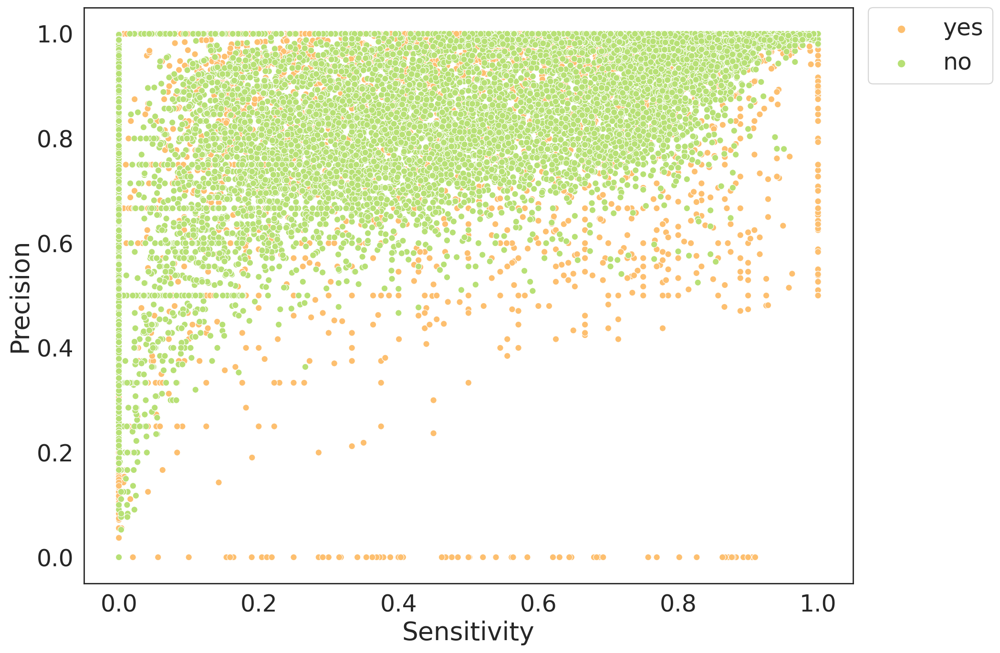

In [12]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
ax = sns.scatterplot(data=df_knime_oob, x="sensitivity", y="precision",
                hue="cyto", palette="RdYlGn", 
                linewidth=0.5, alpha = 1)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_combined_recall-vs-precision_hue-cyto.png', bbox_inches = 'tight')

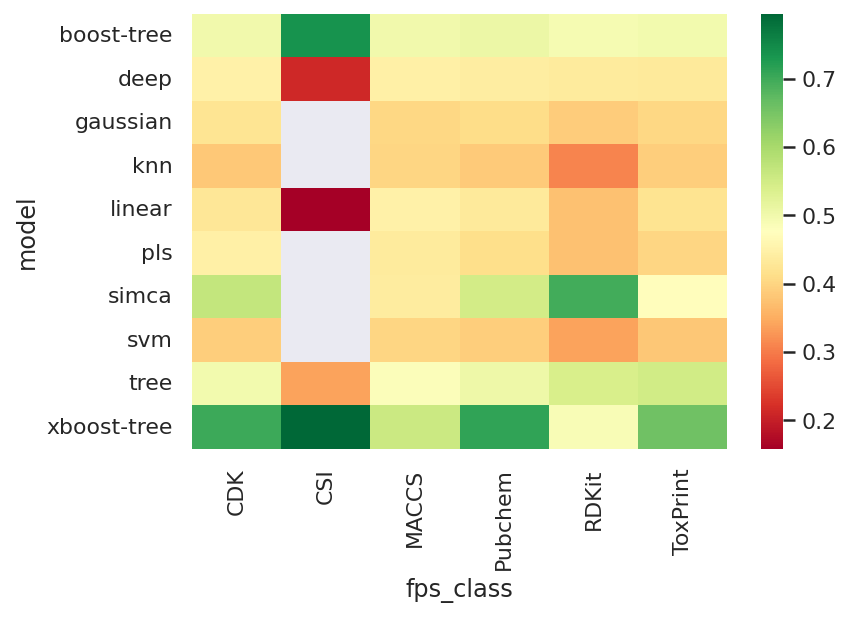

In [55]:
# for the heatmap we present just a subset from knime results. CSI fps were not tested on daint. 
%config InlineBackend.figure_format = 'retina'
df_sel = df_con[["sensitivity", "model", "fps_class"]]
df_sel_avg = df_sel.groupby(["model", "fps_class"], as_index=False).mean('sensitivity')
df_sel_avg_piv = df_sel_avg.pivot("model", "fps_class", "sensitivity")
ax = sns.heatmap(df_sel_avg_piv, cmap="RdYlGn")
#RdYlGn
#PiYG
plt.savefig('../plots/knime/heatmap_model-vs-molfps_meansensitivity.png', bbox_inches = 'tight')

In [ ]:
# for the heatmap we present just a subset from knime results. CSI fps were not tested on daint. 
%config InlineBackend.figure_format = 'retina'
df_sel = df_con[["sensitivity", "model", "fps_class"]]
df_sel_avg = df_sel.groupby(["model", "fps_class"], as_index=False).mean('sensitivity')
df_sel_avg_piv = df_sel_avg.pivot("model", "fps_class", "sensitivity")
ax = sns.heatmap(df_sel_avg_piv, cmap="RdYlGn")
#RdYlGn
#PiYG
plt.savefig('../plots/knime/heatmap_model-vs-molfps_meansensitivity.png', bbox_inches = 'tight')

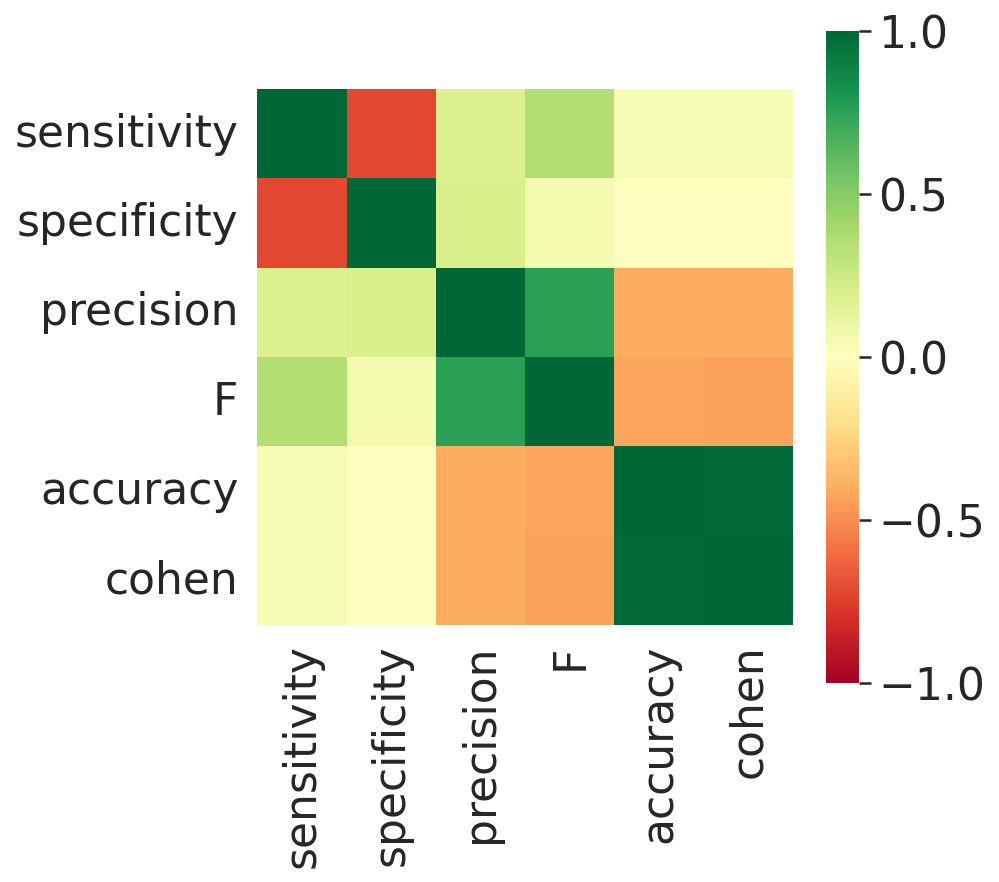

In [14]:
#correlation matrix
%config InlineBackend.figure_format = 'retina'
corrmat = df_con.corr()
f, ax = plt.subplots(figsize=(6, 6))
sns.heatmap(corrmat, vmax=1, vmin=-1, square=True, cmap="RdYlGn");
plt.savefig('../plots/knime/heatmap_modelmetrics_correlation.png', bbox_inches = 'tight')

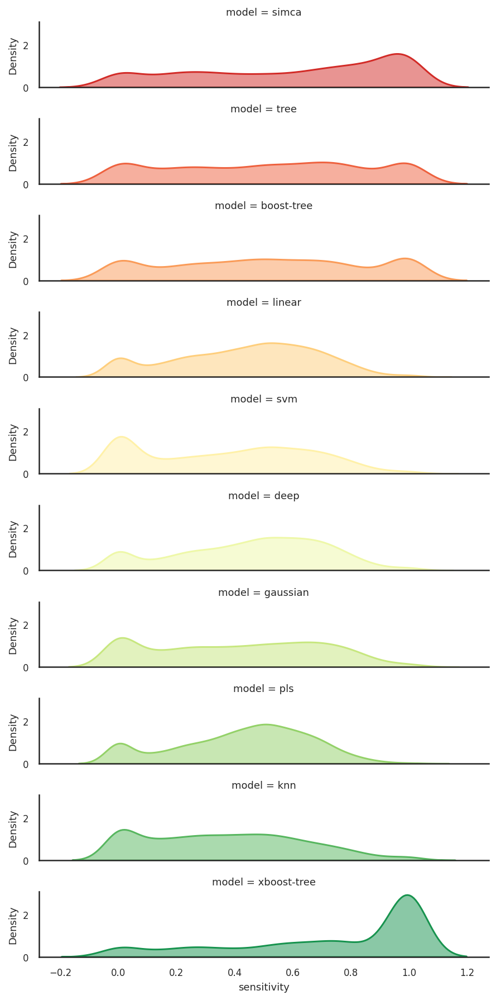

In [68]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_daint, #the dataframe to pull from
                  row="model", #define the column for each subplot row to be differentiated by
                  hue="model", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_daint_model.png', bbox_inches = 'tight')

<AxesSubplot: xlabel='sensitivity', ylabel='Density'>

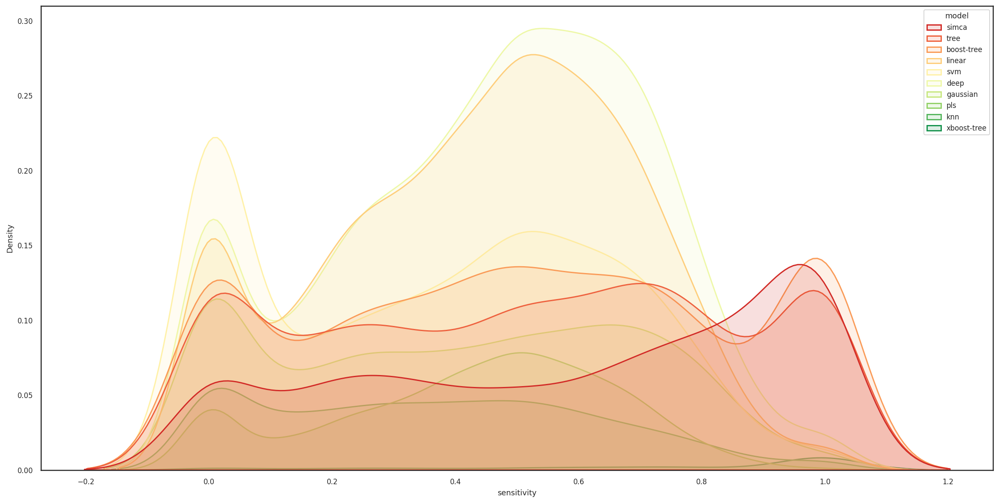

In [72]:
sns.kdeplot(data=df_daint, palette="RdYlGn", x = "sensitivity", hue = "model", fill = True, alpha = 0.15, lw=1.5, bw=0.2)

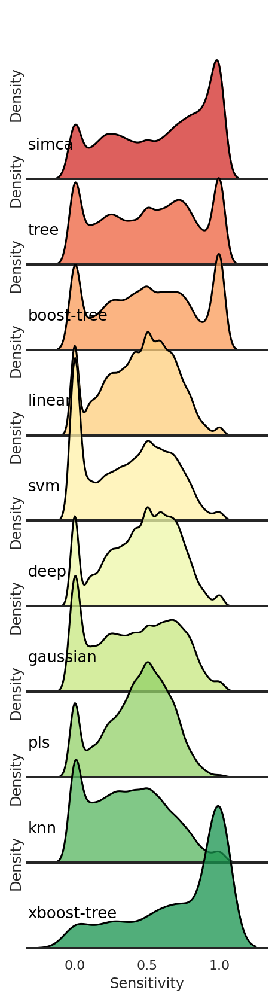

In [95]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 10)
g = sns.FacetGrid(df_daint, palette=palette, row="model", hue="model", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "model")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_daint_model_ridge.svg', bbox_inches = 'tight', dpi=300)

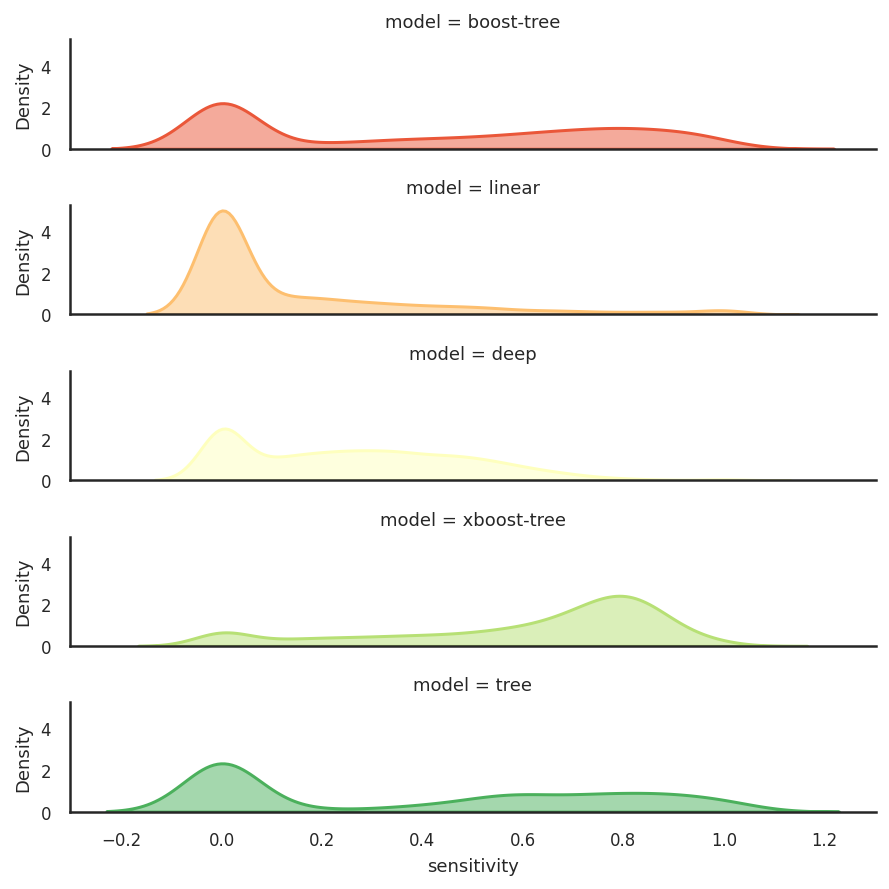

In [16]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_knime_oob, #the dataframe to pull from
                  row="model", #define the column for each subplot row to be differentiated by
                  hue="model", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_knime_oob_model.png', bbox_inches = 'tight')

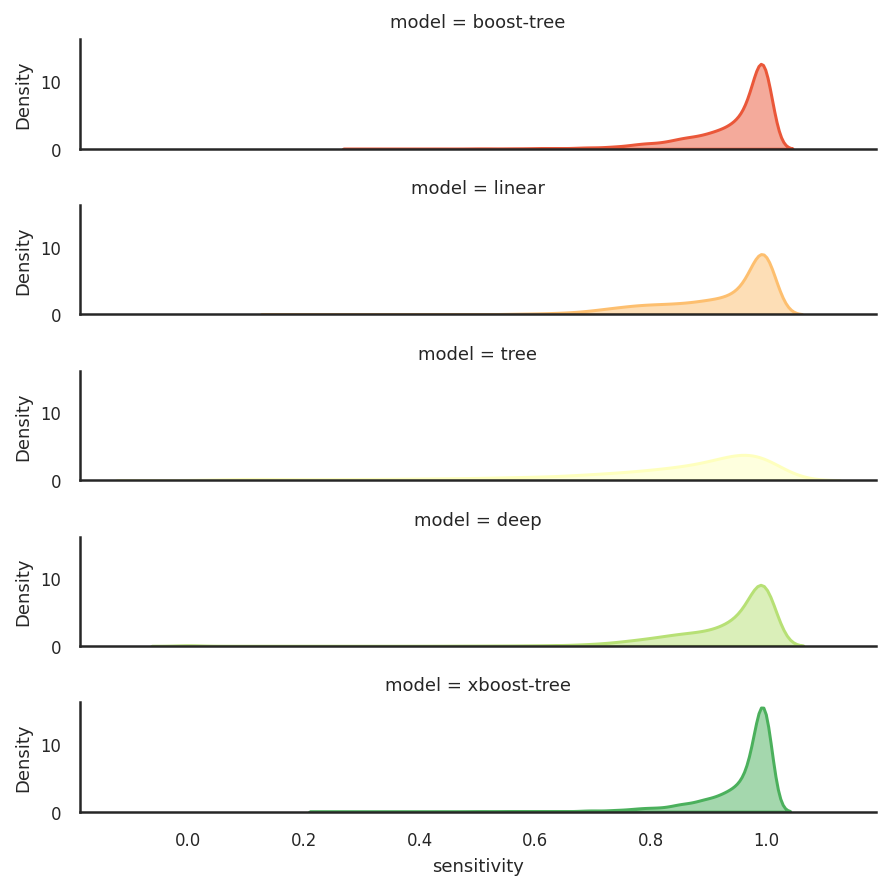

In [17]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_knime_fb, #the dataframe to pull from
                  row="model", #define the column for each subplot row to be differentiated by
                  hue="model", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_knime_fb_model.png', bbox_inches = 'tight')

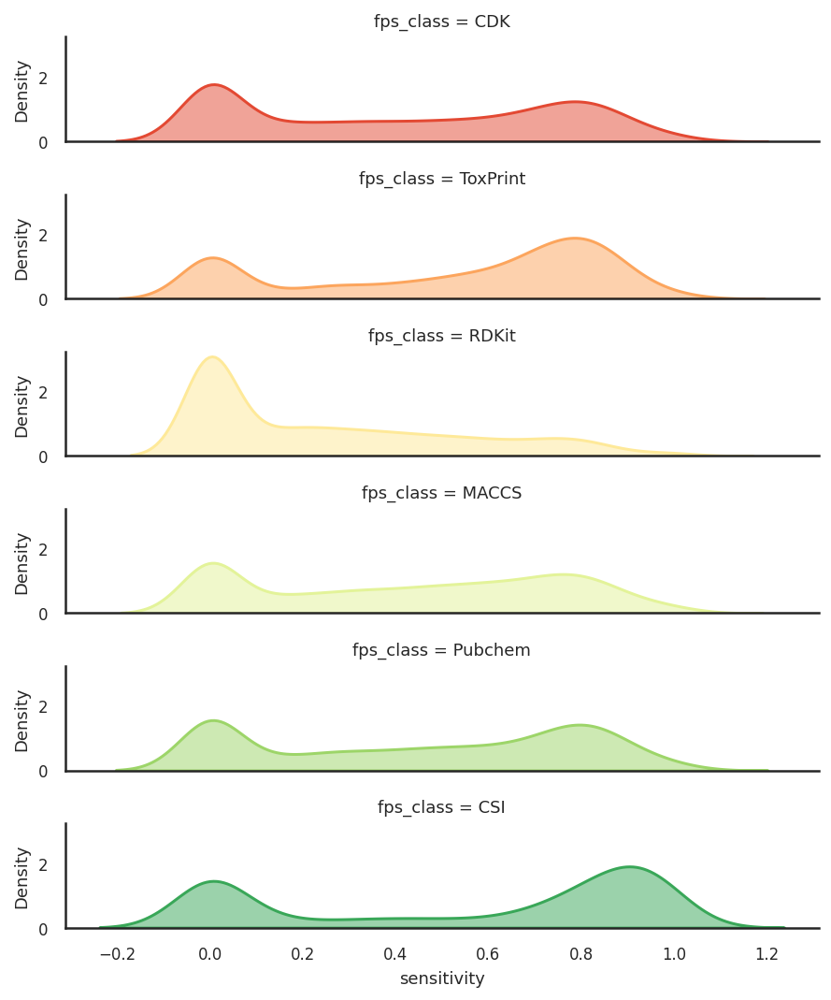

In [18]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_knime_oob, #the dataframe to pull from
                  row="fps_class", #define the column for each subplot row to be differentiated by
                  hue="fps_class", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_knime_oob_fps.png', bbox_inches = 'tight')

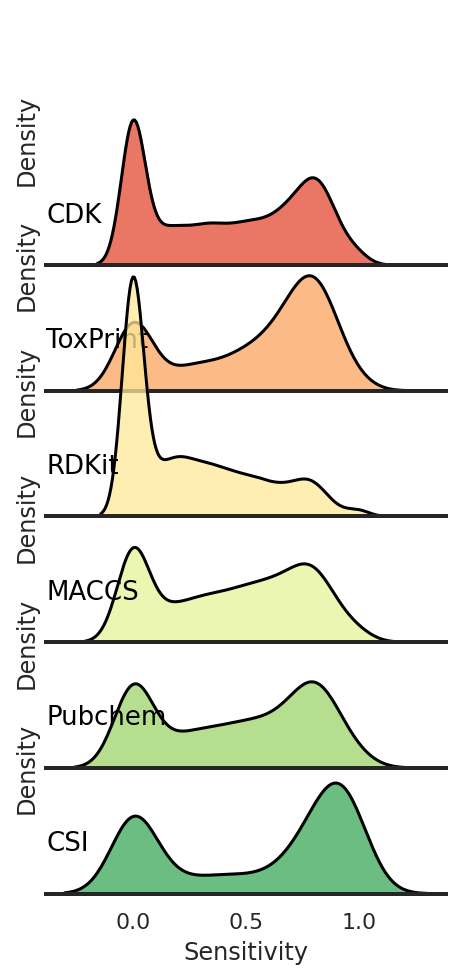

In [96]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 6)
g = sns.FacetGrid(df_knime_oob, palette=palette, row="fps_class", hue="fps_class", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "fps_class")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_fps_class_ridge.svg', bbox_inches = 'tight', dpi=300)

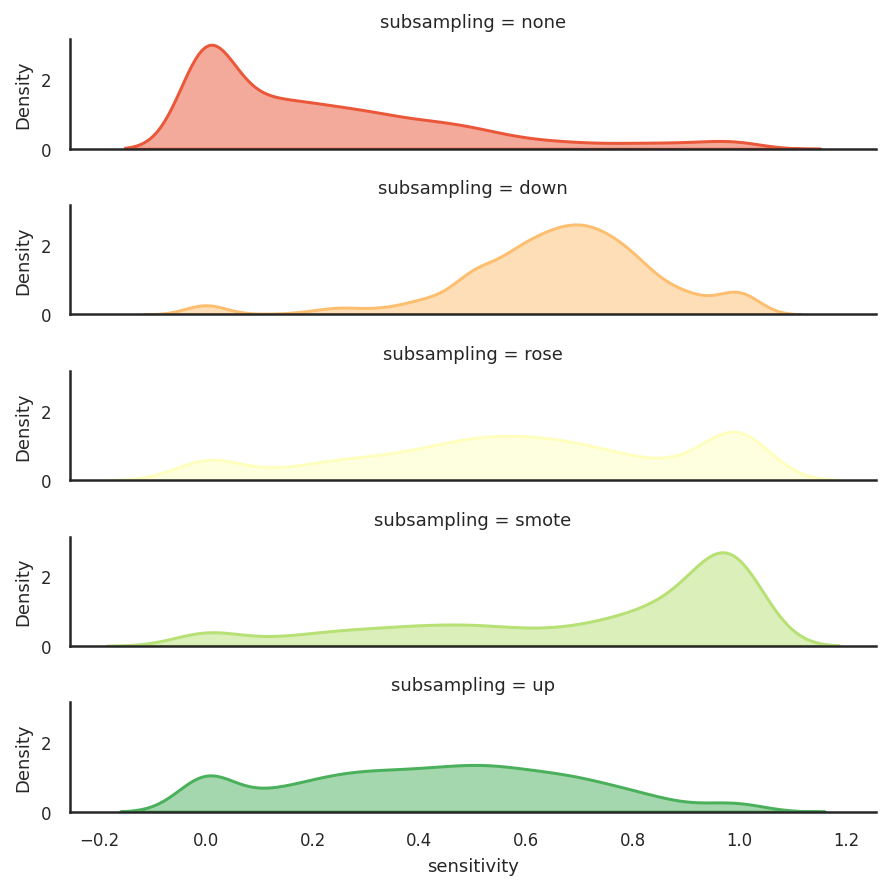

In [19]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df, #the dataframe to pull from
                  row="subsampling", #define the column for each subplot row to be differentiated by
                  hue="subsampling", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_df_subsampling.png', bbox_inches = 'tight')

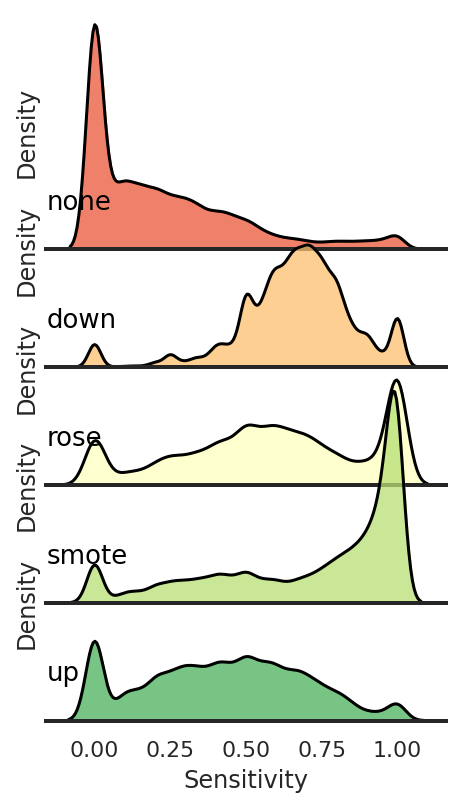

In [97]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 5)
g = sns.FacetGrid(df, palette=palette, row="subsampling", hue="subsampling", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "subsampling")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_subsampling_ridge.svg', bbox_inches = 'tight', dpi=300)

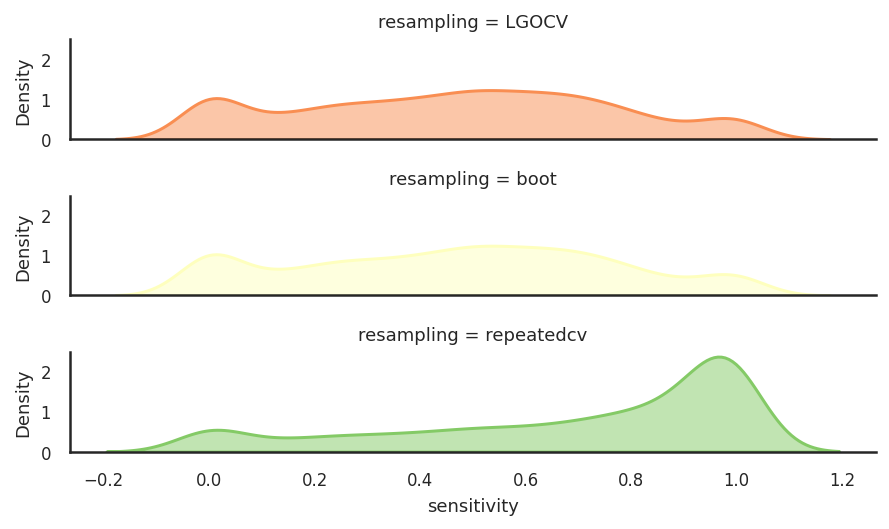

In [20]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df, #the dataframe to pull from
                  row="resampling", #define the column for each subplot row to be differentiated by
                  hue="resampling", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_df_resampling.png', bbox_inches = 'tight')

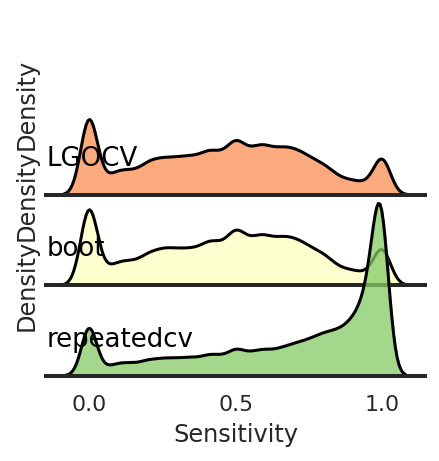

In [98]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df, palette=palette, row="resampling", hue="resampling", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "resampling")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_resampling_ridge.svg', bbox_inches = 'tight', dpi=300)

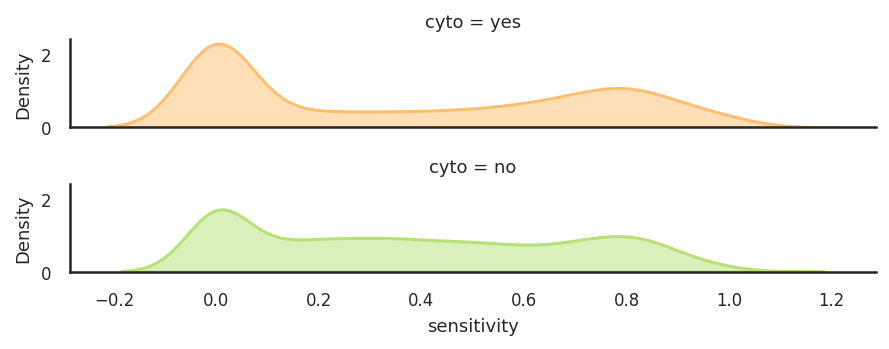

In [56]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_knime_oob, #the dataframe to pull from
                  row="cyto", #define the column for each subplot row to be differentiated by
                  hue="cyto", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_dfknimeoob_cytotox.png', bbox_inches = 'tight')

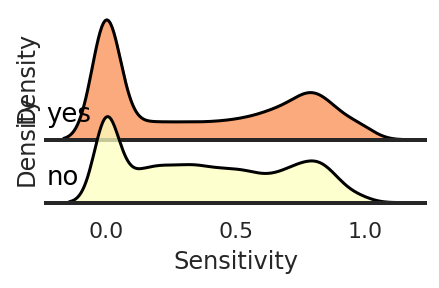

In [99]:
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0), 'axes.linewidth':2})
palette = sns.color_palette("RdYlGn", 3)
g = sns.FacetGrid(df_knime_oob, palette=palette, row="cyto", hue="cyto", aspect=3, height=1.2)
g.map_dataframe(sns.kdeplot, x="sensitivity", fill=True, alpha=0.75)
g.map_dataframe(sns.kdeplot, x="sensitivity", color='black')
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, color='black', fontsize=13,
            ha="left", va="center", transform=ax.transAxes)
    
g.map(label, "cyto")
g.fig.subplots_adjust(hspace=-.5)
g.set_titles("")
g.set(yticks=[], xlabel="Sensitivity")
g.despine(left=True)
#plt.suptitle('ML performance by model', y=0.98)
plt.savefig('../plots/knime/kde_sensitivity_cyto_ridge.svg', bbox_inches = 'tight', dpi=300)

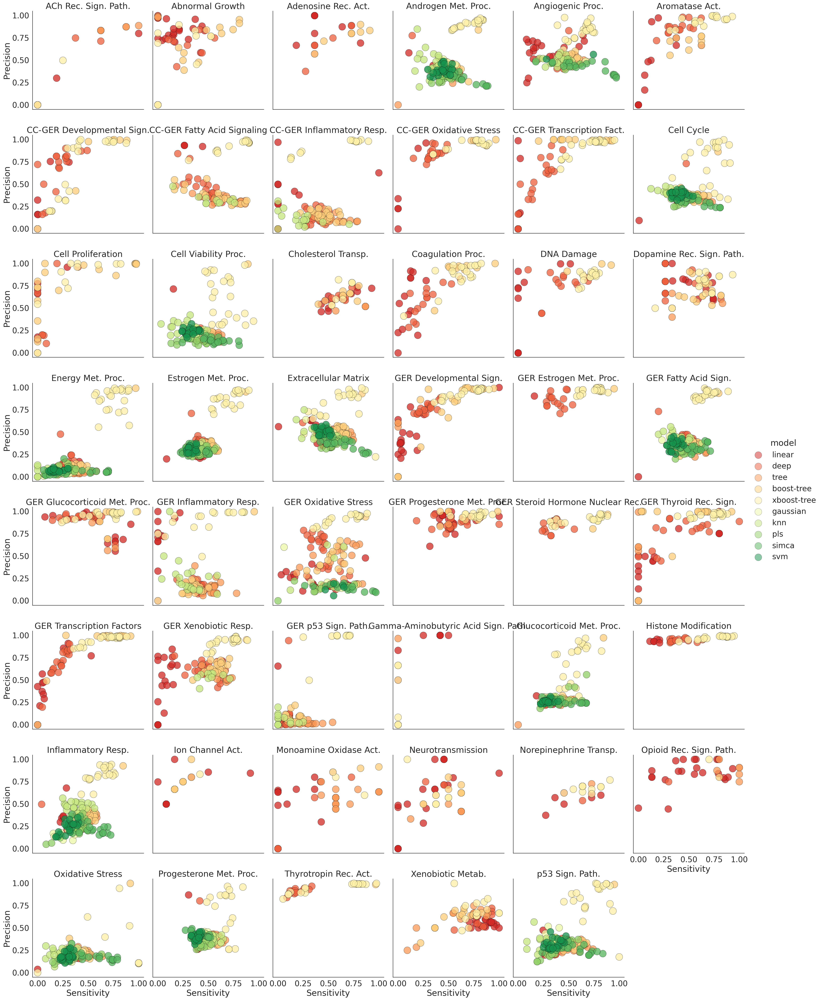

In [20]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']
plt.rcParams.update(rc)
df_con_target_cyto_una = df_con_target_cyto.drop(df_con_target_cyto[df_con_target_cyto['mechT'] == "UNA"].index)
g = sns.FacetGrid(df_con_target_cyto_una, col="mechT", col_wrap=6, hue="model", palette="RdYlGn", height=5)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.50, hue_order = hue_order)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/sensitivity_per_mech_v2.svg', bbox_inches = 'tight', dpi = 300)

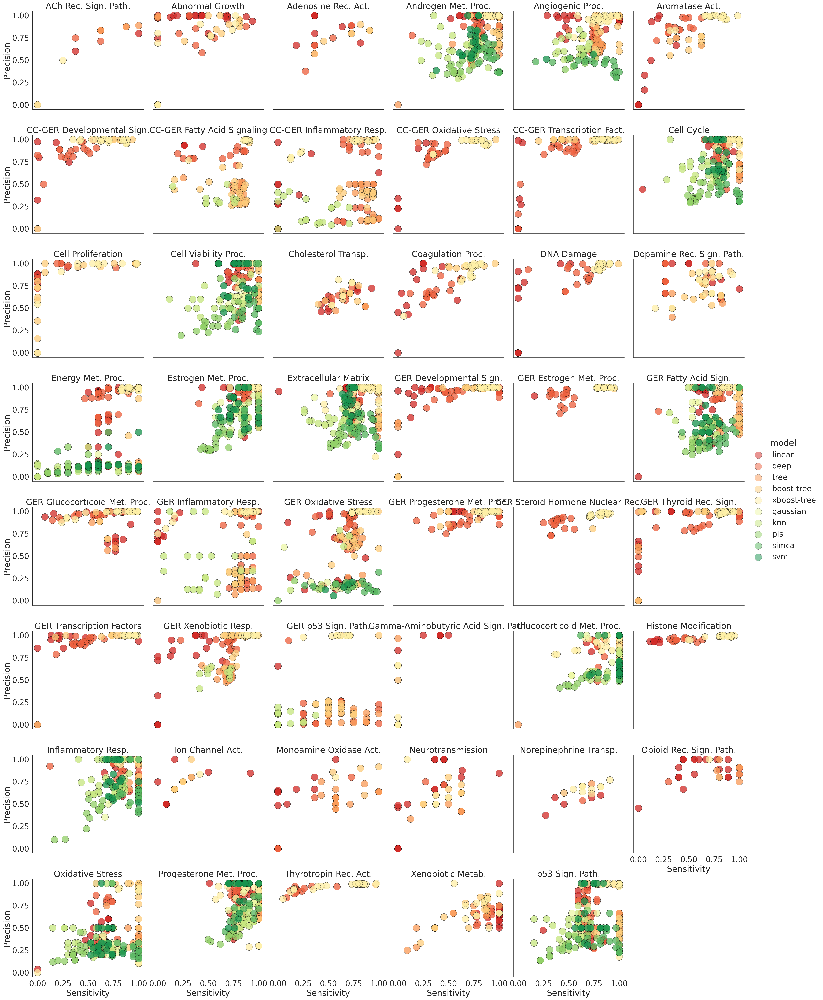

In [21]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)
df_con_target_cyto_una_max = df_con_target_cyto_max.drop(df_con_target_cyto_max[df_con_target_cyto_max['mechT'] == "UNA"].index)
g = sns.FacetGrid(df_con_target_cyto_una_max, col="mechT", col_wrap=6, hue="model", palette="RdYlGn", height=5)
g.map(sns.scatterplot, "sensitivity", "precision", s=400,
      edgecolor = "black", linewidth=0.5, alpha = 0.50)
g.add_legend()
g.set_axis_labels("Sensitivity", "Precision")
g.set(xticks=[0, 0.25, 0.5, 0.75, 1], yticks=[0, 0.25, 0.5, 0.75, 1])
# g.figure.subplots_adjust(wspace=.02, hspace=.02)
g.set_titles(row_template = '{row_name}', col_template = '{col_name}')
plt.savefig('../plots/knime/sensitivity_per_mech_max.svg', bbox_inches = 'tight', dpi = 300)

In [114]:
df_con_target_una_table_target = df_con_target_una[["mechT", "hitc_perc", "DTXSID_unique#", "sensitivity", "accuracy", "specificity", "cohen", "F"]]
df_con_target_una_table_target_mean = df_con_target_una_table_target.groupby("mechT").mean()
df_con_target_una_table_target_mean.head(50)

,hitc_perc,DTXSID_unique#,sensitivity,accuracy,specificity,cohen,F
mechT,,,,,,,
ACh Rec. Sign. Path.,0.41,132.00,0.31,0.57,0.83,0.14,0.68
Abnormal Growth,0.23,314.39,0.23,0.59,0.94,0.17,0.60
Adenosine Rec. Act.,0.48,168.00,0.54,0.69,0.85,0.38,0.62
Androgen Met. Proc.,0.18,1842.67,0.50,0.80,0.81,0.59,0.43
Angiogenic Proc.,0.36,1213.56,0.50,0.74,0.79,0.47,0.54
Aromatase Act.,0.18,4198.90,0.45,0.68,0.91,0.36,0.60
CC-GER Developmental Sign.,0.04,3051.79,0.29,0.64,0.98,0.27,0.56
CC-GER Fatty Acid Signaling,0.08,2949.00,0.59,0.83,0.87,0.65,0.47
CC-GER Inflammatory Resp.,0.02,3127.50,0.39,0.80,0.87,0.61,0.28


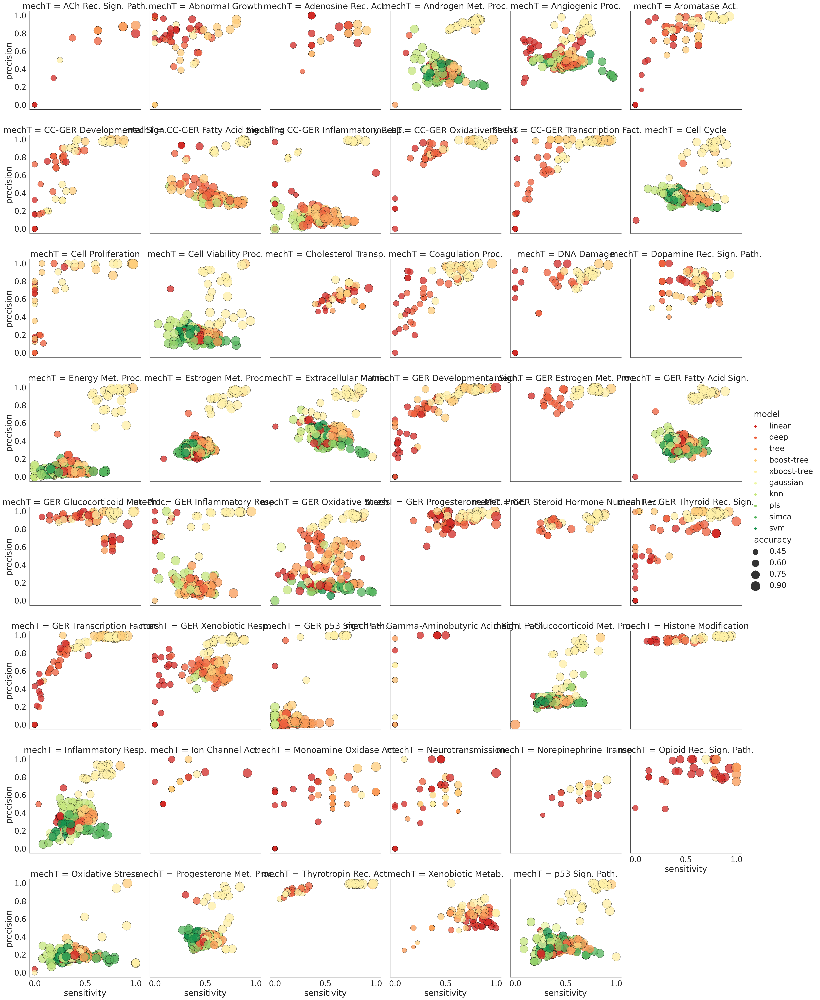

In [102]:
%config InlineBackend.figure_format = 'retina'
df_con_target_cyto_una = df_con_target_cyto.drop(df_con_target_cyto[df_con_target_cyto['mechT'] == "UNA"].index)
df_con_target_cyto_fpsclass
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)
#hue_order =['xboost-tree','boost-tree','tree', 'linear', 'simca', 'knn', 'pls', 'svm','gaussian', 'deep']
sns.relplot(
    data=df_con_target_cyto_una, x="sensitivity", y="precision", col="mechT",col_wrap=6,
    hue="model", size="accuracy",
    palette='RdYlGn', sizes=(100, 800), alpha = 0.5, edgecolor = "black", linewidth=0.5
    #,hue_order=hue_order
)

plt.savefig('../plots/knime/sensitivity_per_mech_v2.svg', bbox_inches = 'tight', dpi = 300)

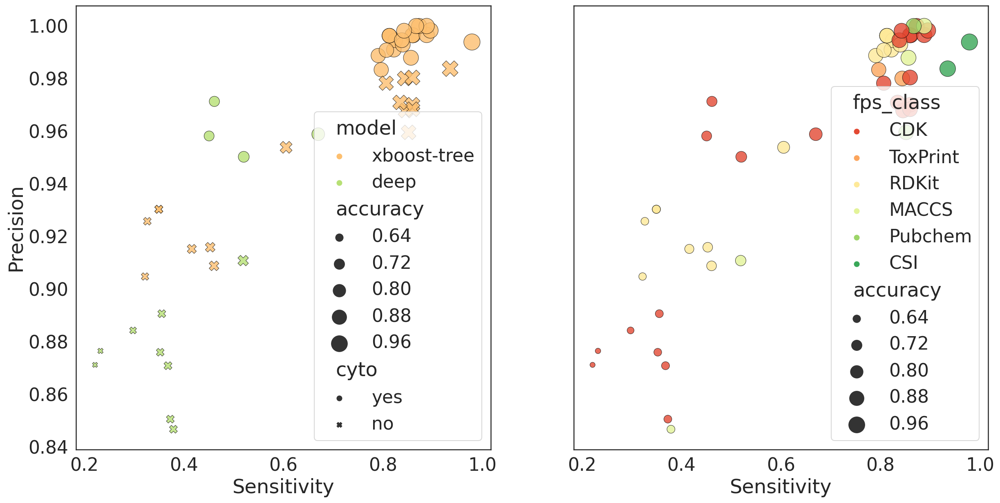

In [24]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)

c891 = df_con["class"] == "class891"
class891 = df_con[df_con["class"] == "class891"]
class891.shape 
class891.columns

hue_order = ["xboost-tree", "deep"]
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=True)
sns.scatterplot(ax=axes[0], data=class891, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", sizes=(40, 400), size="accuracy",
               hue_order=hue_order, edgecolor = "black", linewidth=0.5, style = "cyto", alpha = 0.80)
axes[0].set(xlabel='Sensitivity', ylabel='Precision')
sns.scatterplot(ax=axes[1], data=class891, x="sensitivity", y="precision",
                hue="fps_class", palette="RdYlGn",  sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5,  alpha = 0.80)
axes[1].set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/class891_scatter.png', bbox_inches = 'tight')

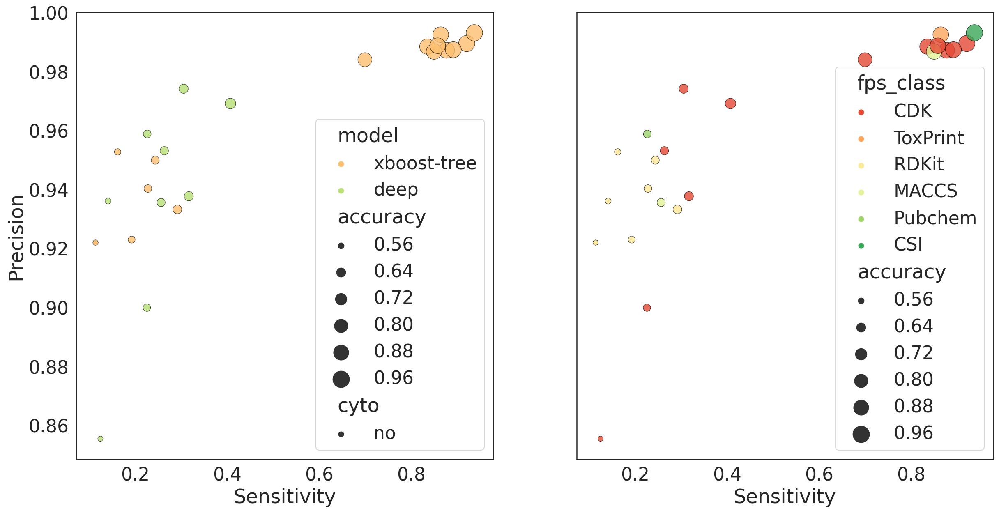

In [25]:
# no data for modeling with CTB as endpoint was removed due to quality filtration
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)

c609 = df_con["class"] == "class609"
class609 = df_con[df_con["class"] == "class609"]

hue_order = ["xboost-tree", "deep"]
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=True)
sns.scatterplot(ax=axes[0], data=class609, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", sizes=(40, 400), size="accuracy",
               hue_order=hue_order, edgecolor = "black", linewidth=0.5, style = "cyto", alpha = 0.80)
axes[0].set(xlabel='Sensitivity', ylabel='Precision')
sns.scatterplot(ax=axes[1], data=class609, x="sensitivity", y="precision",
                hue="fps_class", palette="RdYlGn", sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5,  alpha = 0.80)
axes[1].set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/class609_scatter.png', bbox_inches = 'tight')

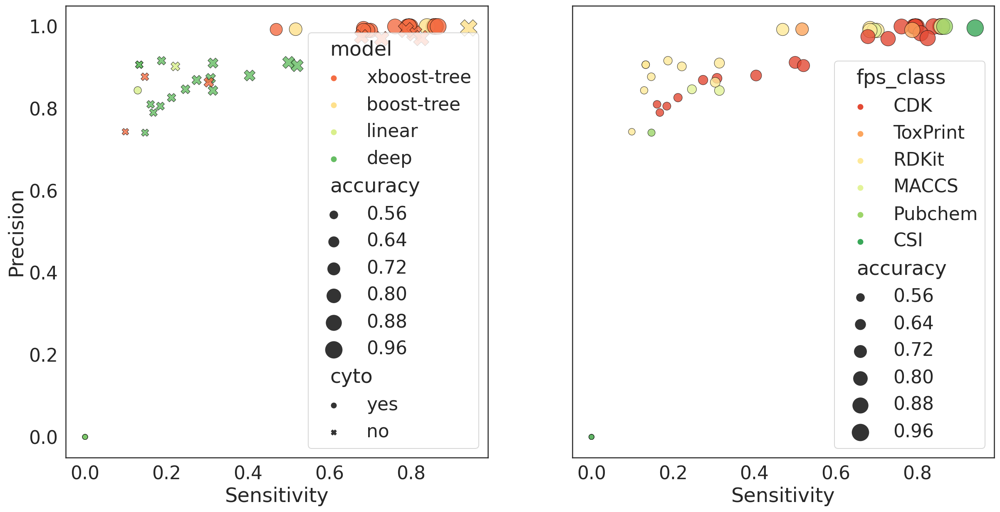

In [26]:
# TOX21_AR_BLA_Agonist_ratio
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)

c761 = df_con["class"] == "class761"
class761 = df_con[df_con["class"] == "class761"]

hue_order = ["xboost-tree", "deep"]
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=True)
sns.scatterplot(ax=axes[0], data=class761, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5, style = "cyto", alpha = 0.80)
axes[0].set(xlabel='Sensitivity', ylabel='Precision')
sns.scatterplot(ax=axes[1], data=class761, x="sensitivity", y="precision",
                hue="fps_class", palette="RdYlGn", sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5,  alpha = 0.80)
axes[1].set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/class761_scatter.png', bbox_inches = 'tight')

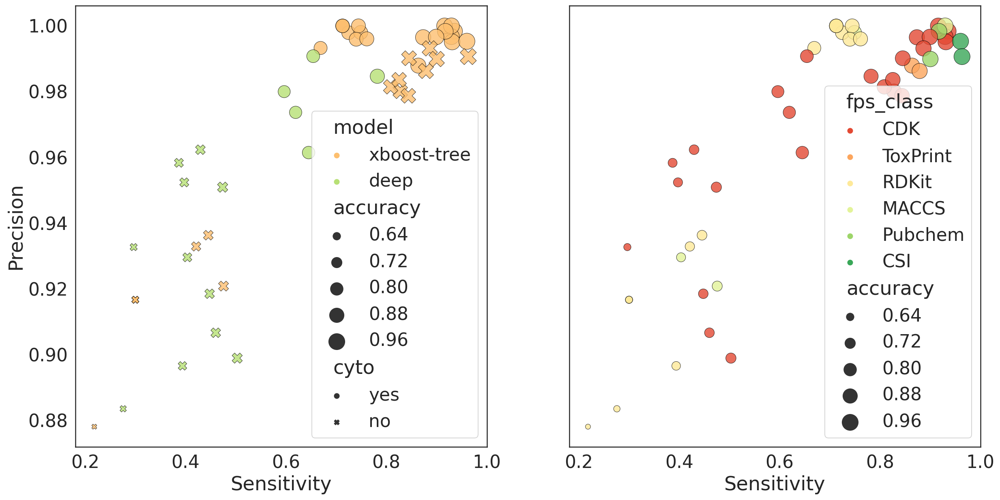

In [27]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      #'font.family':'Times New Roman',
      'font.size' : 15}
plt.rcParams.update(rc)

c893 = df_con["class"] == "class893"
class893 = df_con[df_con["class"] == "class893"]

hue_order = ["xboost-tree", "deep"]
fig, axes = plt.subplots(1, 2, figsize=(20, 10), sharey=True)
sns.scatterplot(ax=axes[0], data=class893, x="sensitivity", y="precision",
                hue="model", palette="RdYlGn", sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5, style = "cyto", alpha = 0.80)
axes[0].set(xlabel='Sensitivity', ylabel='Precision')
sns.scatterplot(ax=axes[1], data=class893, x="sensitivity", y="precision",
                hue="fps_class", palette="RdYlGn", sizes=(40, 400), size="accuracy",
                edgecolor = "black", linewidth=0.5,  alpha = 0.80)
axes[1].set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/class893_scatter.png', bbox_inches = 'tight')

In [11]:
# step 1 independent testing 
df_nonfinal = df.drop(df[df['sampling_independent'] == "no"].index)
# step 2 model
df_nonfinal = df_nonfinal[df_nonfinal['model'] == 'xboost-tree']
# step 3 subsampling
df_nonfinal = df_nonfinal[df_nonfinal['subsampling'] == 'smote']
# step 4 resampling
df_nonfinal = df_nonfinal[df_nonfinal['resampling'] == 'repeatedcv']
# step 5 resampling
print(df_nonfinal.shape)
df_nonfinal.head
#print(df_final['class'].unique())
print(df_nonfinal['class'].nunique())
df_nonfinal_class = pd.merge(df_nonfinal, df_class, on='class')
df_nonfinal_target = df_nonfinal_class.groupby('mechT', as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy' ])
df_nonfinal_class_grouped = df_nonfinal_class.groupby("class").mean()
df_nonfinal_class.shape
print(df_nonfinal_class["class"].nunique())
print(df_nonfinal_class["mechT"].nunique())

(7957, 15)
512
511
47


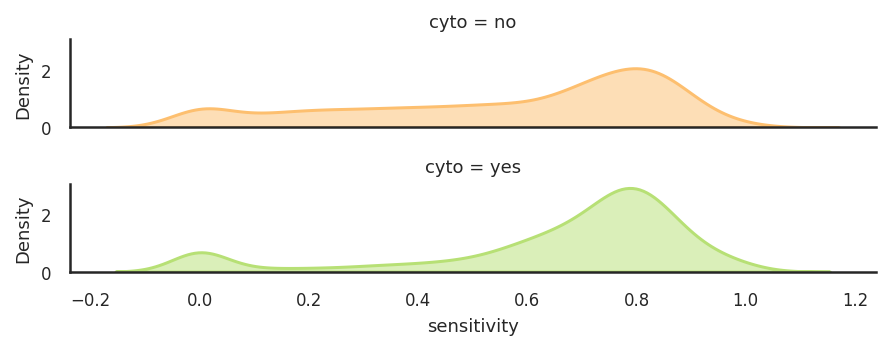

In [29]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 0.75)
sns.set_style("white")
rc = {'figure.figsize':(30,30),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8'}
g = sns.FacetGrid(df_nonfinal, #the dataframe to pull from
                  row="cyto", #define the column for each subplot row to be differentiated by
                  hue="cyto", #define the column for each subplot color to be differentiated by
                  aspect=5, #aspect * height = width
                  height=1.25, #height of each subplot
                  palette='RdYlGn' #google colors
                 )
g.map(sns.kdeplot, "sensitivity", shade=True, alpha=0.5, lw=1.5, bw=0.2)
plt.savefig('../plots/knime/kde_sensitivity_dffinal_cytotox.png', bbox_inches = 'tight')

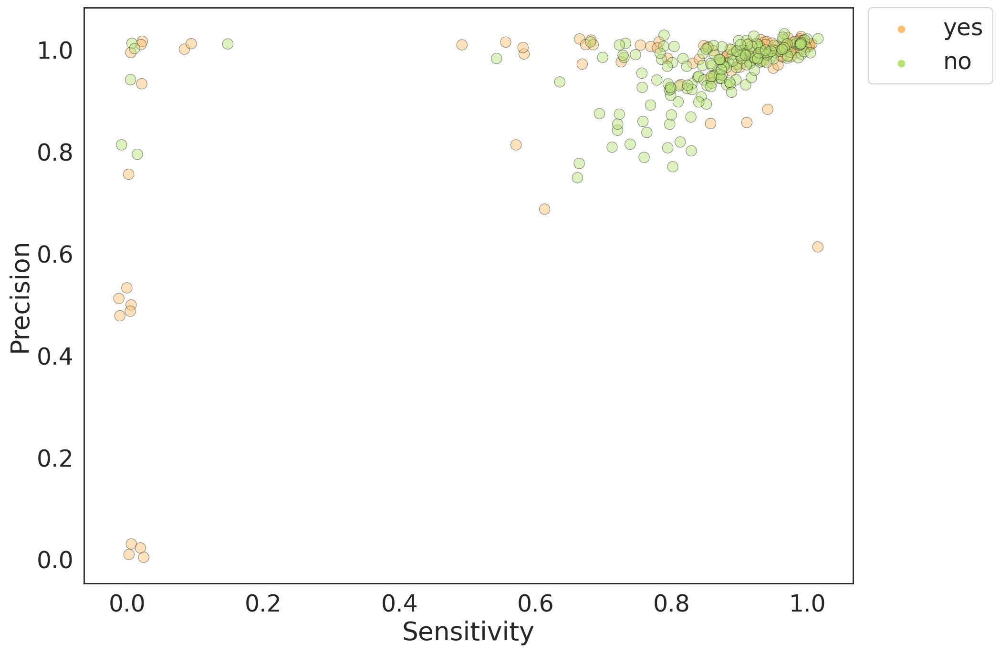

In [59]:

%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
ax = sns.scatterplot(data=df_final, x=jitter(df_final.sensitivity, 0.01), y=jitter(df_final.precision, 0.01),
                hue="cyto", palette="RdYlGn", 
                linewidth=0.5, alpha = 0.45, edgecolor = "black", s=100)
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_dffinal_recall-vs-precision_hue-cyto.png', bbox_inches = 'tight')

In [60]:
df_final.head()

,sensitivity,specificity,precision,F,class,fps,model,subsampling,resampling,cyto,source,sampling_independent,accuracy,cohen,fps_class
528603,0.93,0.87,0.88,0.90,class107,CSI,xboost-tree,smote,repeatedcv,yes,knime-oob,yes,0.90,0.80,CSI
528615,1.00,0.29,0.58,0.74,class171,CSI,xboost-tree,smote,repeatedcv,yes,knime-oob,yes,0.64,0.29,CSI
528640,0.81,0.93,0.92,0.86,class203,CSI,xboost-tree,smote,repeatedcv,yes,knime-oob,yes,0.87,0.74,CSI
528643,0.56,1.00,1.00,0.71,class207,CSI,xboost-tree,smote,repeatedcv,yes,knime-oob,yes,0.78,0.56,CSI
528684,0.00,1.00,0.75,0.61,class405,CSI,xboost-tree,smote,repeatedcv,yes,knime-oob,yes,0.50,0.00,CSI


(272, 15)
218
218
34
['Dopamine Rec. Sign. Path.' 'UNA' 'DNA Damage' 'Xenobiotic Metab.'
 'Monoamine Oxidase Act.' 'Cell Viability Proc.' 'Inflammatory Resp.'
 'Angiogenic Proc.' 'Androgen Met. Proc.' 'Extracellular Matrix'
 'Estrogen Met. Proc.' 'Glucocorticoid Met. Proc.'
 'GER Developmental Sign.' 'GER Xenobiotic Resp.' 'GER Oxidative Stress'
 'CC-GER Transcription Fact.' 'p53 Sign. Path.' 'Aromatase Act.'
 'GER Transcription Factors' 'CC-GER Inflammatory Resp.'
 'GER Fatty Acid Sign.' 'GER Thyroid Rec. Sign.' 'GER Estrogen Met. Proc.'
 'GER Glucocorticoid Met. Proc.' 'GER Progesterone Met. Proc.'
 'Thyrotropin Rec. Act.' 'Cell Cycle' 'Coagulation Proc.'
 'Progesterone Met. Proc.' 'Energy Met. Proc.' 'CC-GER Oxidative Stress'
 'CC-GER Developmental Sign.' 'Histone Modification'
 'GER Steroid Hormone Nuclear Rec.']


<AxesSubplot: >

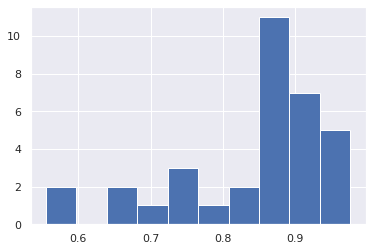

In [ ]:
# step 1 independent testing 
df_final = df.drop(df[df['sampling_independent'] == "no"].index)
# step 2 model
df_final = df_final[df_final['model'] == 'xboost-tree']
# step 3 subsampling
df_final = df_final[df_final['subsampling'] == 'smote']
# step 4 resampling
df_final = df_final[df_final['resampling'] == 'repeatedcv']
# step 5 resampling
df_final = df_final[df_final['fps'] == 'CSI']
print(df_final.shape)
#print(df_final['class'].unique())
print(df_final['class'].nunique())
df_final_class = pd.merge(df_final, df_class, on='class')
#print(df_final_class['mechanisticTargets'].nunique())
#print(df_final_class['mechanisticTargets'].nunique())
df_final_target = df_final_class.groupby('mechT', as_index=False).mean(['sensitivity', 'specificity', 'precision', 'F', 'cohen', 'accuracy'])
print(df_final_class["class"].nunique())
print(df_final_class["mechT"].nunique())
df_final_target.head(5)
targets = df_final_class['mechT'].unique()
print(targets)
df_final_target.sensitivity.

<AxesSubplot: >

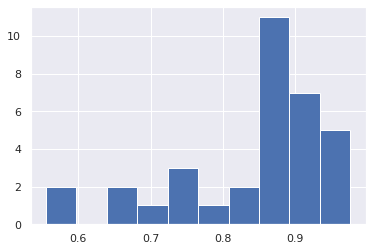

In [15]:
df_final_target.sensitivity.hist()

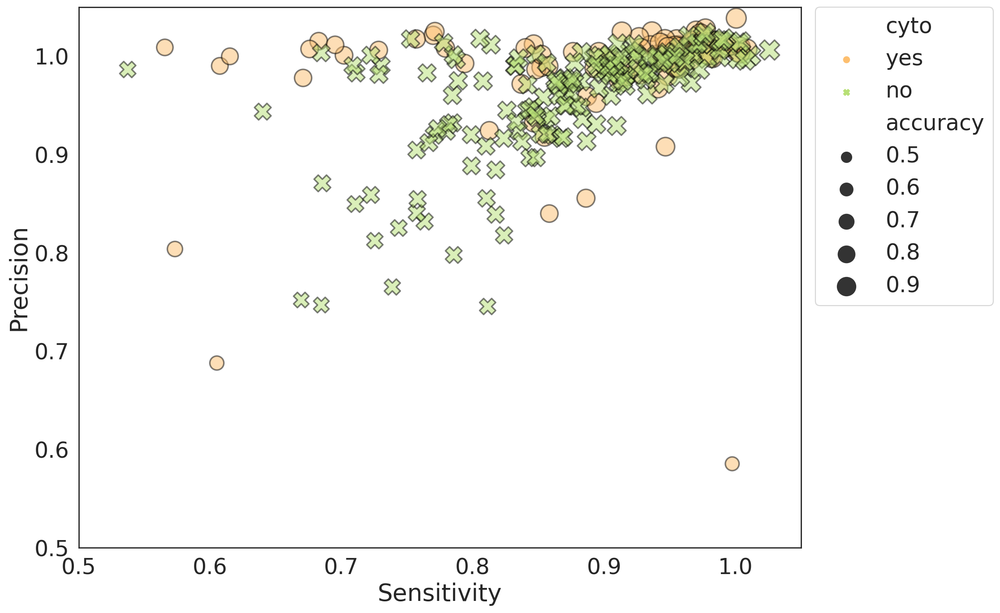

In [65]:
%config InlineBackend.figure_format = 'retina'
def jitter(values,j):
    return values + np.random.normal(j,0.01,values.shape)
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
ax = sns.scatterplot(data =df_final, x=jitter(df_final.sensitivity,0.01), y=jitter(df_final.precision,0.01),
                hue="cyto", style="cyto", palette="RdYlGn", 
                linewidth=1.5, alpha = 0.5, 
                size="accuracy", sizes=(100, 400), 
                edgecolor="black")
ax.set(xlim=(0.5,1.05), ylim=(0.5,1.05))
handles, labels  =  ax.get_legend_handles_labels() 
ax.set_title('')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0) 
ax.set(xlabel='Sensitivity', ylabel='Precision')
plt.savefig('../plots/knime/scatter_combined_recall-vs-precision_hue-cyto_dffinal.png', bbox_inches = 'tight')

In [47]:
df_corr = df_final_target.drop(['ctb', 'hitc_perc', 'aeid_unique#', 'hitc_count'], axis=1)
df_corr = df_corr.rename(columns={'hitc_sum': 'hitc1%', 'DTXSID_unique#': 'DTXSID#'})
corr = df_corr.corr()
corr.style.background_gradient(cmap="RdYlGn")
plt.savefig('../plots/knime/correlation_of_metrics.png', bbox_inches = 'tight')

<Figure size 1440x720 with 0 Axes>

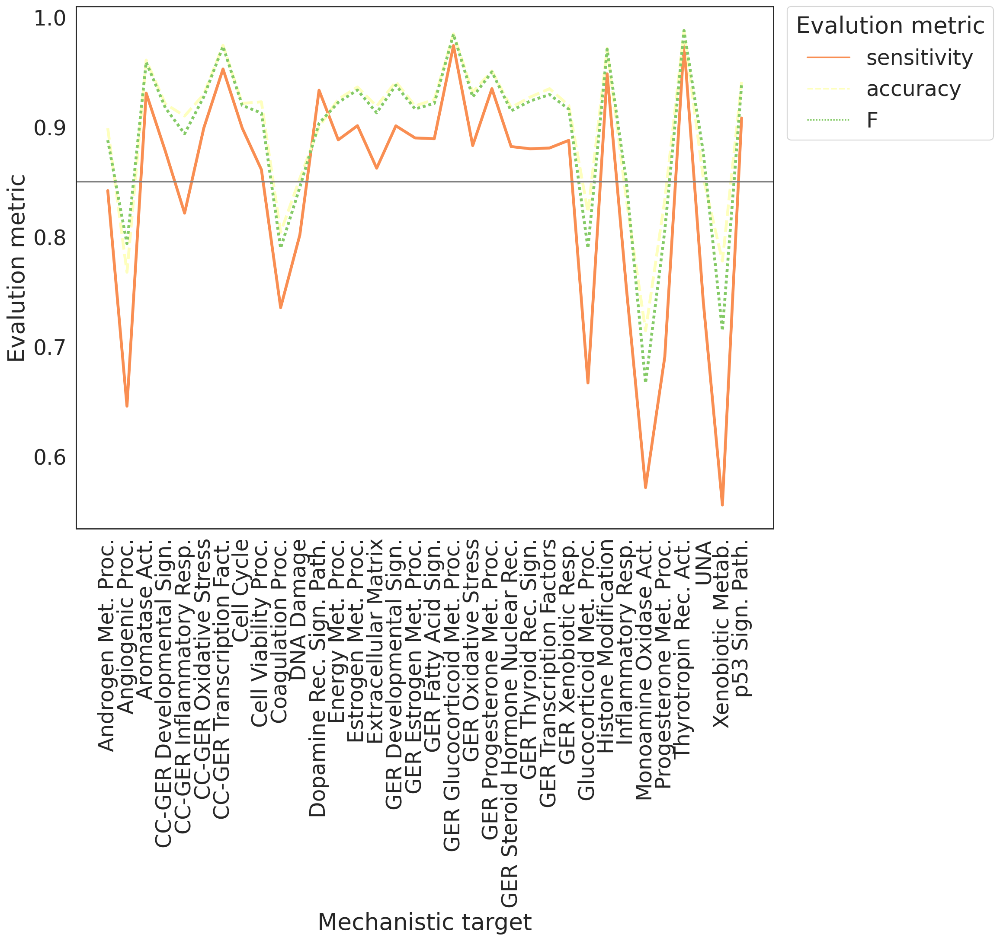

In [ ]:
%config InlineBackend.figure_format = 'retina'
sns.set(font_scale = 2)
sns.set_style("white")
rc = {'figure.figsize':(20,10),
      'axes.facecolor':'white',
      'axes.grid' : False,
      'grid.color': '.8',
      'font.size' : 22}
plt.rcParams.update(rc)
plt.figure(figsize=(13,10), dpi= 80)
sns.set_style("white")
df_final_wide = df_final_target[["mechT", "sensitivity", "accuracy", "F", "cohen", "precision", "specificity"]]
g = sns.lineplot(data=df_final_wide, linewidth = 3, palette="RdYlGn")
g.set_xticks(range(len(df_final_wide))) # <--- set the ticks first
plt.xticks(rotation=90)
g.set_xticklabels(df_final_wide.mechT)
g.axhline(0.85, color = "gray")
g.set(xlabel='Mechanistic target', ylabel='Evalution metric')
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, 
title='Evalution metric')
plt.savefig('../plots/knime/lineplot_datafinal_sens-vs-precision.png', bbox_inches = 'tight')

[]
[1, 2, 3, 4, 1, 2, 5, 3, 6, 7, 4, 8, 1, 2, 3, 4, 5, 6, 1, 2, 1, 2, 3, 4, 1, 2, 3, 4, 5, 6, 7, 8, 1, 2, 1, 2, 1, 2, 3, 4, 1, 2, 9, 10, 1, 2, 11, 12, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 13, 14, 15, 16, 17, 15, 16, 17, 18, 18, 1, 2, 3, 4, 5, 6, 19, 20, 21, 22, 1, 2, 3, 4, 7, 8, 1, 2, 3, 4, 1, 2, 1, 2, 5, 6, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 7, 8, 9, 10, 41, 42, 9, 10, 11, 12, 13, 14, 43, 44, 45, 46, 47, 48, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 49, 50, 51, 52, 53, 54, 11, 12, 5, 5, 6, 7, 6, 7, 8, 8, 9, 10, 1, 2, 3, 4, 11, 12, 13, 14, 15, 16, 17, 18, 55, 56, 57, 58, 1, 2, 3, 4, 59, 60, 61, 62, 23, 63, 64, 65, 66, 24, 67, 68, 3, 4, 1, 2, 3, 4, 69, 70, 71, 72, 3, 4, 5, 6, 7, 8, 9, 10, 1, 2, 3, 4, 5, 6, 7, 8, 13, 14, 15, 16, 9, 10, 11, 12, 19, 20, 21, 5, 6, 22, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 23, 24, 25, 26, 27, 28, 7, 8, 25, 26, 73, 27, 28, 74, 9, 10, 11, 12, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 11, 12, 75, 76, 77, 78, 1, 2, 3, 4, 

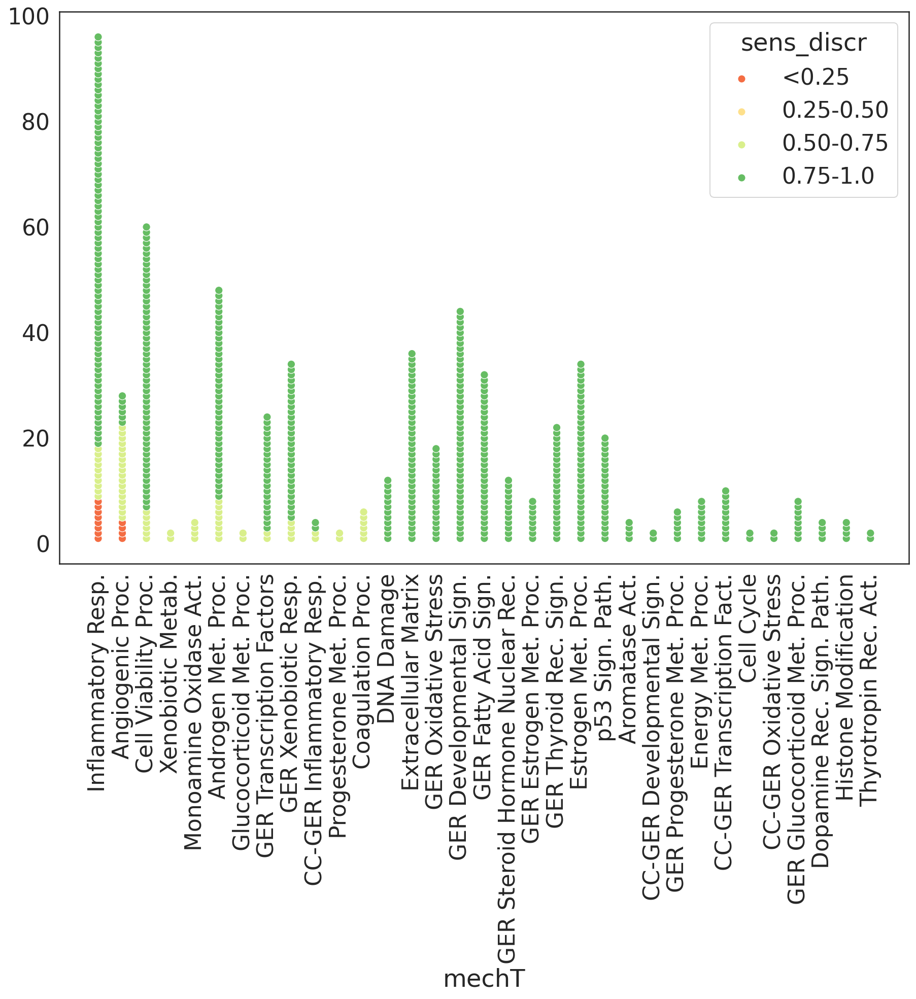

In [61]:
%config InlineBackend.figure_format = 'retina'
df_final_class_dot = df_final_class.sort_values(by=['sensitivity'])
df_final_class_dot = df_final_class_dot.drop(df_final_class_dot[df_final_class_dot['mechT'] == "UNA"].index)
# Loop to create a new variable, which will turn scatterplot to a dot plot
mechT_count = []
print(mechT_count)
for index, mechT in enumerate(df_final_class_dot['mechT']):
    subset = df_final_class_dot.iloc[:index + 1] # Create subset starting at the beginning of dataset until the movie itself
    count = len(subset[subset['mechT'] == mechT]) # Count all movies from the same year in this subset
    mechT_count.append(count)  # Appended counts will be used as vertical values in the scatterplot,
    # which will help to create a dot plot
print(mechT_count)
df_final_class_dot['sens_discr'] = pd.cut(df_final_class_dot.sensitivity, bins=4, labels=['<0.25', '0.25-0.50', '0.50-0.75', '0.75-1.0'], right=False)
# Data for the plot
x = df_final_class_dot['mechT']
y = mechT_count
hue = df_final_class_dot['sens_discr']
sns.set_style("white")
# Dot plot created using scatter plot
plt.figure(figsize=(15, 10))
ax = sns.scatterplot(x=x, y=y, hue=hue, s=60, legend="full", palette="RdYlGn")
plt.xticks(rotation=90)
plt.savefig('../plots/knime/dotplot_datafinal_endpointspermech.png', bbox_inches = 'tight')

In [ ]:
df_final.head()